In [0]:
from pyspark.sql import SparkSession, Row
import pandas as pd
import pyspark
from pyspark.sql import SQLContext
sqlContext = SQLContext(sc)

from pyspark.ml.feature import CountVectorizer , IDF
from pyspark.ml.feature import CountVectorizer, CountVectorizerModel, IDF, RegexTokenizer, StopWordsRemover
from pyspark.ml.clustering import LDA, LocalLDAModel
from pyspark.sql.window import Window
import pyspark.sql.functions as F
from pyspark.sql.functions import explode
from pyspark.sql.functions import flatten
import pyspark.sql.types as T

from pyspark.sql.types import *
from pyspark.sql.functions import col

In [0]:

df = sqlContext.read.parquet("/dbfs/FileStore/vector_no_stopw_df.parquet")

In [0]:
df.printSchema

Out[42]: <bound method DataFrame.printSchema of DataFrame[paper_id: string, doi: string, abstract: string, body_text: string, authors: string, title: string, journal: string, abstract_summary: string, abstract_word_count: bigint, body_word_count: bigint, body_unique_words: bigint, language: string, text: string, vector: array<string>, vector_no_stopw: array<string>]>

In [0]:

def is_digit(value):
    if value:
        return value.isdigit()
    else:
        return False
filter_number_udf = udf(lambda row: [x for x in row if not is_digit(x)], ArrayType(StringType()))
temp = df
temp = temp.withColumn('no_number_vector_removed', filter_number_udf(col('vector_no_stopw')))

In [0]:
temp1= temp.select(temp.paper_id,explode(temp.no_number_vector_removed))
temp2 = temp1.filter(temp1.col != "")
temp3 = temp2.groupby("paper_id").agg(F.collect_list("col").alias("vector_removed"))
inner_join = temp3.join(temp, ["paper_id"])


In [0]:
windowSpec  = Window.orderBy(F.col("paper_id"))
df_final = inner_join.withColumn("id",F.row_number().over(windowSpec))


In [0]:
df_txts = df_final.select("vector_removed", "id","paper_id", "doi", "title", "authors", "abstract", "abstract_summary", "vector_no_stopw")
# TF
cv = CountVectorizer(inputCol="vector_removed", outputCol="raw_features", vocabSize=5000, minDF=5.0)
cvmodel = cv.fit(df_txts)
result_cv = cvmodel.transform(df_txts)
# IDF
idf = IDF(inputCol="raw_features", outputCol="features")
idfModel = idf.fit(result_cv)
result_tfidf = idfModel.transform(result_cv)

In [0]:
k_values = []
logPerplexity = []
max_iterations=100
for num in range(5,305, 5):
  print(num)
  num_topics=num
  k_values.append(num)
  lda = LDA(k=num_topics, maxIter=max_iterations)
  ldaModel = lda.fit(result_tfidf)
  lp = ldaModel.logPerplexity(result_tfidf)
  print("Perplexity: " + str(lp) )
  logPerplexity.append(lp)

5
Perplexity: 6.628572730737432
10
Perplexity: 6.519438801569265
15
Perplexity: 6.397236720819847
20
Perplexity: 6.3598167031017105
25
Perplexity: 6.387990079179527
30
Perplexity: 6.525549464920003
35
Perplexity: 6.312706035111975
40
Perplexity: 6.2285512943840065
45
Perplexity: 6.412161787657163
50
Perplexity: 6.41039970281414
55
Perplexity: 6.266132119365329
60
Perplexity: 6.473524931103461
65
Perplexity: 6.260698911705018
70
Perplexity: 6.267222498108107
75
Perplexity: 6.352164960478526
80
Perplexity: 6.268672621219726
85
Perplexity: 6.261188192840874
90
Perplexity: 6.577898343091236
95
Perplexity: 6.040289625388686
100
Perplexity: 6.283878462726922
105
Perplexity: 6.16236142599303
110
Perplexity: 6.429503457703897
115
Perplexity: 6.2799143312979675
120
Perplexity: 6.182512751009261
125
Perplexity: 6.097559139175709
130
Perplexity: 6.255260329872354
135
Perplexity: 6.273764801135394
140
Perplexity: 6.234753276589587
145
Perplexity: 6.188926301351012
150
Perplexity: 6.001342081501391
155
Perplexity: 6.330656993666518
160
Perplexity: 6.47349240078256
165
Perplexity: 6.285430941999541
170
Perplexity: 6.3644567665434915
175
Perplexity: 6.529841059477355
180
Perplexity: 6.311361804640987
185
Perplexity: 6.301131974928282
190
Perplexity: 6.273706890118594
195
Perplexity: 6.3174495104579105
200
Perplexity: 6.442210315751927
205
Perplexity: 6.126556051620245
210
Perplexity: 6.408360634062154
215
Perplexity: 6.574985092716269
220
Perplexity: 6.349506697939982
225
Perplexity: 6.4453846380867725
230
Perplexity: 6.336590628577661
235
Perplexity: 6.1987967014392105
240
Perplexity: 6.2227937914720695
245
Perplexity: 6.088240932208598
250
Perplexity: 6.461217338926206
255
Perplexity: 6.345381000687106
260
Perplexity: 6.332298598710354
265
Perplexity: 6.0124631842156555
270
Perplexity: 6.374243774307981
275
Perplexity: 6.224857668288167
280
Perplexity: 6.372324290922859
285
Perplexity: 6.378601770221679
290
Perplexity: 6.384956848300974
295
Perplexity: 6.3925382716929855
300
Perplexity: 6.442837646186788

In [0]:
path = "/dbfs/FileStore/FileStore/LDA/"
df = pd.DataFrame(data={"number of clusters": k_values, "log Perplexity score": logPerplexity})
df.to_csv("/dbfs/FileStore/tables/findK.csv", sep=',',index=False)

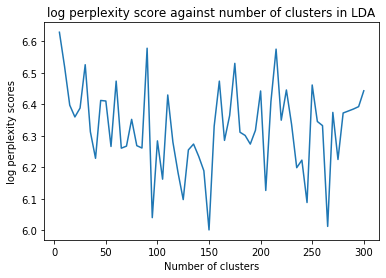

In [0]:
import matplotlib.pyplot as plt 
  
# x axis values 
x = k_values
# corresponding y axis values 
y = logPerplexity 
  
# plotting the points  
plt.plot(x, y) 
  
# naming the x axis 
plt.xlabel('Number of clusters') 
# naming the y axis 
plt.ylabel('log perplexity scores') 
  
# giving a title to my graph 
plt.title('log perplexity score against number of clusters in LDA') 
  
# function to show the plot 
plt.show() 

In [0]:
lda = LDA(k=150, maxIter=50)
ldaModel = lda.fit(result_tfidf)

In [0]:
# Print topics and top-weighted terms
topics = ldaModel.describeTopics(maxTermsPerTopic=10)
vocabArray = cvmodel.vocabulary

numTopics=10

ListOfIndexToWords = udf(lambda wl: list([vocabArray[w] for w in wl]))
FormatNumbers = udf(lambda nl: ["{:1.4f}".format(x) for x in nl])

topics.select(ListOfIndexToWords(topics.termIndices).alias('words')).show(truncate=False, n=numTopics)
topics.select(FormatNumbers(topics.termWeights).alias('weights')).show(truncate=False, n=numTopics)

+-----------------------------------------------------------------------------------------------------------+
words |
+-----------------------------------------------------------------------------------------------------------+
[hcws, pregnancy, women, pregnant, maternal, mother, fetal, birth, mothers, delivery] |
[mab, mabs, antibody, antibodies, protein, neutralizing, sera, elisa, rbd, neutralization] |
[covid19, staff, care, patients, healthcare, hospital, hospitals, patient, pandemic, medical] |
[calves, colostrum, ev71, calf, diarrhea, fecal, herds, herd, milk, dairy] |
[cats, cat, fip, feline, fcov, horses, fipv, equine, signs, animals] |
[surgery, surgical, postoperative, anesthesia, surgeons, catheter, resuscitation, procedure, patient, neck]|
[genes, expression, gene, mrna, transcripts, rna, transcript, differentially, splicing, proteins] |
[vaccine, vaccination, vaccines, vaccinated, immunization, taiwan, measles, coverage, immunity, influenza] |
[price, economic, market, energy, prices, climate, demand, gdp, markets, economy] |
[fusion, pro, membrane, proteins, sialic, domain, entry, binding, hcv, glycoproteins] |
+-----------------------------------------------------------------------------------------------------------+
only showing top 10 rows

+--------------------------------------------------------------------------------+
weights |
+--------------------------------------------------------------------------------+
[0.0559, 0.0508, 0.0476, 0.0465, 0.0237, 0.0159, 0.0151, 0.0121, 0.0109, 0.0100]|
[0.0191, 0.0186, 0.0166, 0.0164, 0.0112, 0.0110, 0.0108, 0.0103, 0.0101, 0.0096]|
[0.0121, 0.0114, 0.0110, 0.0096, 0.0088, 0.0083, 0.0082, 0.0065, 0.0065, 0.0061]|
[0.1177, 0.0294, 0.0285, 0.0281, 0.0205, 0.0172, 0.0154, 0.0150, 0.0137, 0.0131]|
[0.1402, 0.0489, 0.0446, 0.0430, 0.0336, 0.0245, 0.0169, 0.0083, 0.0059, 0.0052]|
[0.0362, 0.0250, 0.0163, 0.0105, 0.0085, 0.0084, 0.0070, 0.0067, 0.0063, 0.0060]|
[0.0382, 0.0210, 0.0197, 0.0170, 0.0145, 0.0098, 0.0094, 0.0084, 0.0083, 0.0080]|
[0.0708, 0.0622, 0.0376, 0.0199, 0.0166, 0.0142, 0.0135, 0.0108, 0.0070, 0.0060]|
[0.0124, 0.0123, 0.0114, 0.0108, 0.0105, 0.0097, 0.0094, 0.0084, 0.0077, 0.0076]|
[0.0299, 0.0262, 0.0135, 0.0129, 0.0111, 0.0108, 0.0103, 0.0103, 0.0099, 0.0098]|
+--------------------------------------------------------------------------------+
only showing top 10 rows

In [0]:
df = ldaModel.transform(result_tfidf) #defining the dataframe
numTopics_toShow=10 #
topWords = topics.select(ListOfIndexToWords(topics.termIndices).alias('words')).take(numTopics_toShow)

nTopDoc = 1  # show single top document (1) or also second (2) ..

for i in range(0, numTopics_toShow):
    ntopic = i  # which topic 
    print('Topic ' + str(ntopic) + '\n')  

    df_sliced = df.select("id","topicDistribution","title", "abstract_summary").rdd.map(lambda r: Row(ID=int(r[0]), weight=float(r[1][ntopic]), title = r[2], abstract_summary = r[3])).toDF()
    df_need = df_sliced.sort(df_sliced.weight.desc())
    print("Relevant documents are: ")
    for i in range(5):
      DocIDs = df_need.take(nTopDoc+i)
      print(DocIDs[i])
    print('===================================================')

Topic 0

Relevant documents are:

In [0]:
df.select("id", "topicDistribution").show(2, False)

+---+--------------------------------------------------------------------------------------------------------+
id |topicDistribution |
+---+--------------------------------------------------------------------------------------------------------+
1 |[0.3244902793170352,1.726219846830394E-4,0.6750426651715666,1.3807459502968556E-4,1.5635893168534042E-4]|
2 |[7.043470573681659E-5,4.918944551706084E-5,7.393851797592553E-5,3.934452468153344E-5,0.9997670928060887]|
+---+--------------------------------------------------------------------------------------------------------+
only showing top 2 rows

In [0]:
## find the top documents according to lda for topic number ntopic
ntopic = 5 
nTopDoc = 2 

df_sliced = df.select("id","topicDistribution").rdd.map(lambda r: Row(ID = int(r[0]),
                                                                         sliced = float(r[1][ntopic]))).toDF()
topDocID = df_sliced.sort(df_sliced.sliced.desc()).take(nTopDoc)[nTopDoc-1][0]
print(topDocID)
print('Topic ' + str(ntopic) +'\n')

print('Second Document:',DocIDs)
df_txts.filter(df_txts.id == topDocID)\
    .select('vector_removed')\
    .show()

print('Top 5 terms:')
print(topics.select(ListOfIndexToWords(topics.termIndices).alias('words')).take(numTopics)[ntopic][0])

42387
Topic 5

Second Document: [Row(ID=21125, weight=0.5560428265658766)]
+--------------------+
 vector_removed|
+--------------------+
[covid19, pandemi...|
+--------------------+

Top 5 terms:
[participants, students, learning, training, mental]

In [0]:
# to store the features 
find_cluster = udf(lambda row: int(np.argmax(row)))
temp.select("id","cluster_id", "features").toPandas().to_csv("/dbfs/FileStore/FileStore/lda_25.csv", index = False, header = True)

/databricks/spark/python/pyspark/sql/pandas/conversion.py:93: UserWarning: toPandas attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Unable to convert the field features. If this column is not necessary, you may consider dropping it or converting to primitive type before the conversion.
Context: Unsupported type in conversion to Arrow: VectorUDT
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)

In [0]:
pd.set_option('display.max_colwidth', None)
full = pd.read_csv("/dbfs/FileStore/FileStore/lda_25.csv")
full[["features"]].head(5)

features 
 
 
 
 
 0 
 (1000,[0,1,2,3,6,7,9,11,12,13,14,17,19,20,21,22,23,24,25,28,30,32,39,44,46,49,53,58,63,68,71,78,86,87,92,97,103,109,119,124,134,138,139,145,147,150,152,159,160,161,165,166,168,174,198,202,203,205,211,212,217,219,236,244,249,254,267,274,279,282,284,289,298,308,317,321,328,330,338,353,363,368,390,399,450,463,476,482,496,506,513,514,533,534,538,543,554,568,571,579,585,594,602,603,613,616,619,627,636,638,639,657,658,663,671,682,691,721,727,733,745,746,748,779,786,800,808,812,825,840,877,891,894,899,927,928,981],[0.4282047704242643,2.7792023374379644,0.04770463284900912,0.17161093900494195,8.163672316801796,1.2223604973876512,0.08485834824421132,0.9787080840024995,1.3424786385495093,0.5499495127518842,0.25905992424069285,0.37576198543519984,0.11838394665551287,0.6181382120723918,0.5205664773655846,1.4814690827191894,0.37178892250644374,0.35168627905329775,0.3725016698676884,1.8928748141222607,0.5551828920526876,0.6363519408659896,0.19848375965984738,0.5380449388185159,0.988066083499584,1.5541518462447885,0.9969774409083914,3.3368772252950083,2.097302199802852,0.501777716776715,0.8275027716981155,1.2545038585871275,0.5668386193972594,0.6841951023187889,1.8614872584199116,0.5307371894576156,0.916808829239976,1.6677008865568341,0.5655445161683983,0.7023310061589723,0.5422055401337557,1.3368717546753215,1.0850243880852168,0.7835546220826909,0.7239248465496256,2.815969662611603,0.5950989942982163,0.6720964412789584,2.0996297835707254,2.116226598037615,1.0653698887830505,0.6317614520124213,0.8411546090029363,2.4539870377227198,0.9435009016865492,1.6670125876316533,1.0330470456549294,0.7511200925104897,0.8704576052455618,0.7569085250300638,2.2443603311256903,1.2016899662160427,0.9789940377124915,1.127475446728567,1.1796647331746426,1.6673567074845304,0.9589562197631085,0.7662173005801106,1.132036684185388,1.8435722669281593,2.7995109651239813,1.1837729449199719,1.1718432709101292,1.1613155945064462,2.616120136788595,1.525400787690621,3.6362381755767736,1.132765764582224,1.2452461160189925,1.2983471725479268,1.0551026365499625,1.2886916566153037,1.0912703461533024,1.310113634570841,1.051397851307909,1.521432042433814,5.399791974992652,2.0462921203632836,1.326798650225568,2.1080591856708875,3.37083808336776,1.7584240994186993,2.211259555817049,3.9111366545594413,1.4361295412039121,1.3402113358519443,1.3681339788621076,1.4564046432615727,1.3950471522294854,1.2990516184130005,1.188178392414241,1.176646569880251,1.5599644839429163,2.9749827434377822,1.8162134200530706,1.1565512499489738,5.097327434099832,1.2659751600640567,1.4842351927252135,1.7623985193556915,1.5782223376433782,1.6913129683726578,1.4939881343447816,3.9766609467041216,1.550203868358899,3.6523563942662287,1.5430328625271363,1.3081758410710251,1.4183283502159318,1.2890791934361514,2.249611166293312,1.342007914670077,3.5500948086838386,1.4822113292805326,21.887065567468508,1.7470235753866634,1.5429329324780876,16.32876110309789,1.7727813997215172,1.6695860682577892,1.5543392315571622,1.4413517202711716,2.7491459770938187,1.8236611394353819,1.5033087572303603,2.0183370788297963,1.8103210368920652]) 
 
 
 1 
 (1000,[0,2,3,4,5,7,8,9,10,11,12,14,15,16,17,18,19,20,21,23,24,26,27,33,35,36,37,39,41,42,44,47,51,52,53,55,56,57,60,61,62,68,70,72,75,78,82,84,85,86,88,89,92,97,99,101,102,105,106,110,112,115,117,122,123,125,126,127,128,133,142,145,148,149,150,156,160,163,166,172,173,174,176,177,178,179,184,186,189,190,201,205,208,211,216,221,229,238,240,246,258,260,269,272,281,286,289,291,311,317,320,326,327,340,341,347,351,355,363,370,391,397,399,400,404,409,417,420,430,431,434,435,436,440,441,442,444,446,452,456,457,464,469,492,506,509,517,518,520,525,527,545,550,563,564,582,604,610,617,628,637,641,642,646,677,685,706,721,723,725,727,729,733,736,745,747,771,783,809,819,820,837,848,855,856,908,910,911,927,931,939,941,943,944,966,976,987],[1.0899757792617637,0.38163706279207293,0.40042552434486456,47.77310090193726,2.871659465651031,2.4447209947753024,1.4063321292256357

In [0]:
%matplotlib inline 
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
sns.set_style("whitegrid")
import pandas as pd

%matplotlib inline is not supported in Databricks.
Try using '%matplotlib inline' instead.

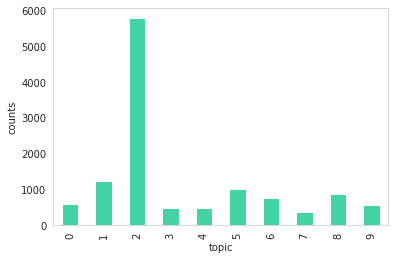

In [0]:
import numpy as np
countTopDocs = df.select('topicDistribution')\
                .rdd.map(lambda r: Row( nTopTopic = int(np.argmax(r)))).toDF() \
                .groupBy("nTopTopic").count().sort("nTopTopic").limit(10)

pdf = countTopDocs.toPandas()
#pdfLess = pdf.drop(pdf.index[[1,3,7,8,10]]).reset_index()

pdf.plot(color = '#44D3A5', legend = False,
                           kind = 'bar', use_index = True, y = 'count', grid = False)
plt.xlabel('topic')
plt.ylabel('counts')

plt.show()

In [0]:
df_txts.filter(df_txts.id == idd).select("vector_removed").collect()

In [0]:
model_number = "_1"
path = "/dbfs/FileStore/FileStore/LDA/"
cvmodel.save(path + 'CVModel'+ model_number)
ldaModel.save(path + 'LDAModel'+ model_number)
lda.save(path + 'LDA'+ model_number)

In [0]:
!pip install pyLDAvis

In [0]:
from pyspark.ml.feature import StopWordsRemover,Tokenizer, RegexTokenizer, CountVectorizer, IDF
from pyspark.sql.functions import udf, col, size, explode, regexp_replace, trim, lower, lit
from pyspark.sql.types import ArrayType, StringType, DoubleType, IntegerType, LongType
from pyspark.ml.clustering import LDA
import pyLDAvis
import numpy as np


def format_data_to_pyldavis(df_filtered, count_vectorizer, transformed, lda_model):
    xxx = df_filtered.select((explode(df_filtered.vector_removed)).alias("words")).groupby("words").count()
    word_counts = {r['words']:r['count'] for r in xxx.collect()}
    word_counts = [word_counts[w] for w in count_vectorizer.vocabulary]


    data = {'topic_term_dists': np.array(lda_model.topicsMatrix().toArray()).T, 
            'doc_topic_dists': np.array([x.toArray() for x in transformed.select(["topicDistribution"]).toPandas()['topicDistribution']]),
            'doc_lengths': [r[0] for r in df_filtered.select(size(df_filtered.vector_removed)).collect()],
            'vocab': count_vectorizer.vocabulary,
            'term_frequency': word_counts}

    return data
  
def filter_bad_docs(data):
    bad = 0
    doc_topic_dists_filtrado = []
    doc_lengths_filtrado = []

    for x,y in zip(data['doc_topic_dists'], data['doc_lengths']):
        if np.sum(x)==0:
            bad+=1
        elif np.sum(x) != 1:
            bad+=1
        elif np.isnan(x).any():
            bad+=1
        else:
            doc_topic_dists_filtrado.append(x)
            doc_lengths_filtrado.append(y)

    data['doc_topic_dists'] = doc_topic_dists_filtrado
    data['doc_lengths'] = doc_lengths_filtrado

# FORMAT DATA AND PASS IT TO PYLDAVIS
data = format_data_to_pyldavis(df_final, cvmodel, df, ldaModel)
filter_bad_docs(data) # this is, because for some reason some docs apears with 0 value in all the vectors, or the norm is not 1, so I filter those docs.
py_lda_prepared_data = pyLDAvis.prepare(**data)
pyLDAvis.display(py_lda_prepared_data)    
  